# Análise de dados do Airbnb

## Por Eugênio, Isabella, João, Julia e Rafael

* city: cidade da listagem (nossa variável)
* weekdays: retorna True se é dia da semana (e não fim de semana) (nossa variável)
* realSum: o preço de acomodação para duas pessoas por duas noites, em euros
* room_type: tipo de acomodação (quarto privado, quarto compartilhado ou casa inteira)
* room_shared: retorna True se o quarto for compartilhado
* room_private: retorna True se o quarto for privado
* person_capacity: número máximo de pessoas 
* host_is_superhost: retorna True se o anfitrião é um Superhost
* multi: retorna True se são oferecidos 2 a 4 quartos diferentes
* biz: retorna True se são oferecidos mais de 4 quartos diferentes
* cleanliness_rating: avaliação da limpeza
* guest_satisfaction_overall: nota geral da listagem
* bedrooms: número de quartos (0 para estúdios)
* dist: distância até o centro da cidade em km
* metro_dist: distância do metrô mais próximo em km
* attr_index: índice de atratividade da localização da listagem
* attr_index_norm: índice de atração normalizado (0-100)
* rest_index: índice de restaurantes da localização da listagem
* rest_index_norm: índice de restaurantes normalizado (0-100)
* lng: longitude da localização da listagem
* lat: latitude da localização da listagem

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import seaborn as sns
%matplotlib inline
import glob
import os
import geopandas as gpd
import warnings
warnings.filterwarnings("ignore")

In [2]:
# União de todos os arquivos (20 arquivos, dois para cada cidade - em dias da semana e fim de semana)
# Criação de colunas para as cidades e para definir se é um dia da semana ou não
all_files = glob.glob('*.csv')

li = []

for filename in all_files:
    print(filename)
    df_temp = pd.read_csv(filename, index_col=0)
    df_temp["city"] = filename[:filename.index('_')].title()
    df_temp["weekdays"] = True if filename[filename.index('_')+1:filename.index('.')] == "weekdays" else False
    li.append(df_temp)

df = pd.concat(li, axis=0, ignore_index=True)
display(df)

amsterdam_weekdays.csv
amsterdam_weekends.csv
athens_weekdays.csv
athens_weekends.csv
barcelona_weekdays.csv
barcelona_weekends.csv
berlin_weekdays.csv
berlin_weekends.csv
budapest_weekdays.csv
budapest_weekends.csv
lisbon_weekdays.csv
lisbon_weekends.csv
london_weekdays.csv
london_weekends.csv
paris_weekdays.csv
paris_weekends.csv
rome_weekdays.csv
rome_weekends.csv
vienna_weekdays.csv
vienna_weekends.csv


,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,...,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,city,weekdays
0,194.033698,Private room,False,True,2.0,False,1,0,10.0,93.0,...,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,Amsterdam,True
1,344.245776,Private room,False,True,4.0,False,0,0,8.0,85.0,...,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,Amsterdam,True
2,264.101422,Private room,False,True,2.0,False,0,1,9.0,87.0,...,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,Amsterdam,True
3,433.529398,Private room,False,True,4.0,False,0,1,9.0,90.0,...,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,Amsterdam,True
4,485.552926,Private room,False,True,2.0,True,0,0,10.0,98.0,...,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,Amsterdam,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51702,715.938574,Entire home/apt,False,False,6.0,False,0,1,10.0,100.0,...,0.530181,0.135447,219.402478,15.712158,438.756874,10.604584,16.37940,48.21136,Vienna,False
51703,304.793960,Entire home/apt,False,False,2.0,False,0,0,8.0,86.0,...,0.810205,0.100839,204.970121,14.678608,342.182813,8.270427,16.38070,48.20296,Vienna,False
51704,637.168969,Entire home/apt,False,False,2.0,False,0,0,10.0,93.0,...,0.994051,0.202539,169.073402,12.107921,282.296424,6.822996,16.38568,48.20460,Vienna,False
51705,301.054157,Private room,False,True,2.0,False,0,0,10.0,87.0,...,3.044100,0.287435,109.236574,7.822803,158.563398,3.832416,16.34100,48.19200,Vienna,False


In [3]:
# Reordenação das colunas do dataframe
df = df[['city', 'weekdays', 'realSum', 'room_type', 'room_shared', 'room_private',
       'person_capacity', 'host_is_superhost', 'multi', 'biz',
       'cleanliness_rating', 'guest_satisfaction_overall', 'bedrooms', 'dist',
       'metro_dist', 'attr_index', 'attr_index_norm', 'rest_index',
       'rest_index_norm', 'lng', 'lat']]

## Visualização básica do Dataframe

In [4]:
# Verifica-se que o dataframe possui 21 colunas, das quais 4 são booleanas, 13 são numéricas, 2 são categóricas (texto)
# e 2 são numéricas contendo informações de latitude e longitude
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51707 entries, 0 to 51706
Data columns (total 21 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   city                        51707 non-null  object 
 1   weekdays                    51707 non-null  bool   
 2   realSum                     51707 non-null  float64
 3   room_type                   51707 non-null  object 
 4   room_shared                 51707 non-null  bool   
 5   room_private                51707 non-null  bool   
 6   person_capacity             51707 non-null  float64
 7   host_is_superhost           51707 non-null  bool   
 8   multi                       51707 non-null  int64  
 9   biz                         51707 non-null  int64  
 10  cleanliness_rating          51707 non-null  float64
 11  guest_satisfaction_overall  51707 non-null  float64
 12  bedrooms                    51707 non-null  int64  
 13  dist                        517

In [5]:
# Pegando 5 linhas aleatórias para verificar como os dados estão dispostos
df.sample(5).T

,21081,12557,26147,32473,3460
city,Lisbon,Berlin,London,Paris,Athens
weekdays,False,False,True,True,True
realSum,265.947467,208.703375,374.420847,382.141859,82.487756
room_type,Entire home/apt,Entire home/apt,Entire home/apt,Private room,Entire home/apt
room_shared,False,False,False,False,False
room_private,False,False,False,True,False
person_capacity,3.0,3.0,3.0,2.0,3.0
host_is_superhost,True,False,False,False,True
multi,1,0,0,1,0
biz,0,0,1,0,0


In [6]:
# Gerando descrições estatísticas básicas
df.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
city,51707,10,London,9993,NaN,NaN,NaN,NaN,NaN,NaN,NaN
weekdays,51707,2,False,26207,NaN,NaN,NaN,NaN,NaN,NaN,NaN
realSum,51707.0,NaN,NaN,NaN,279.879591,327.948386,34.779339,148.752174,211.343089,319.694287,18545.450285
room_type,51707,3,Entire home/apt,32648,NaN,NaN,NaN,NaN,NaN,NaN,NaN
room_shared,51707,2,False,51341,NaN,NaN,NaN,NaN,NaN,NaN,NaN
room_private,51707,2,False,33014,NaN,NaN,NaN,NaN,NaN,NaN,NaN
person_capacity,51707.0,NaN,NaN,NaN,3.161661,1.298545,2.0,2.0,3.0,4.0,6.0
host_is_superhost,51707,2,False,38475,NaN,NaN,NaN,NaN,NaN,NaN,NaN
multi,51707.0,NaN,NaN,NaN,0.291353,0.45439,0.0,0.0,0.0,1.0,1.0
biz,51707.0,NaN,NaN,NaN,0.350204,0.477038,0.0,0.0,0.0,1.0,1.0


In [7]:
# Verificando número de linhas e colunas do DF
df.shape

(51707, 21)

<AxesSubplot: >

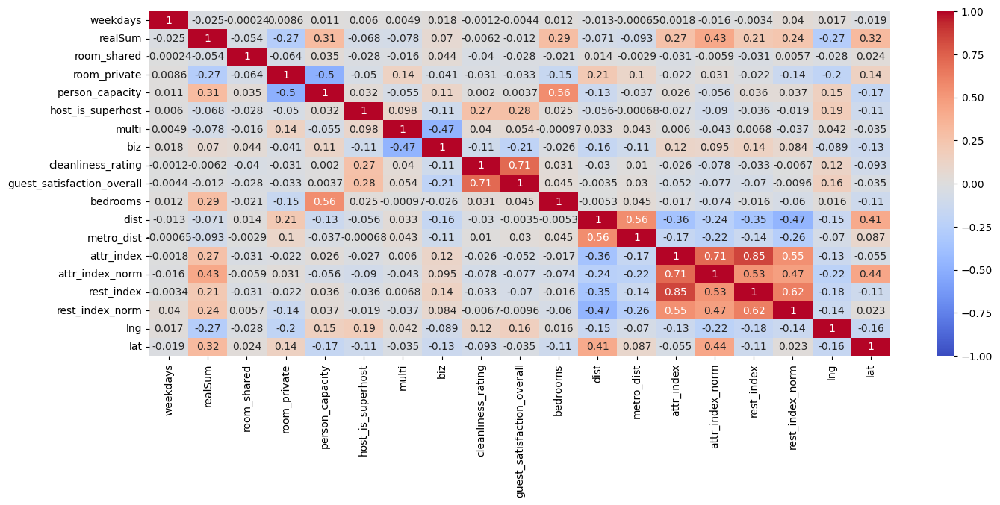

In [54]:
# Como funciona a correlação entre as variáveis?
# Verifica-se que a correlação é baixa, com exceção de 
plt.figure(figsize=(16, 6))
sns.heatmap(df[df['realSum']<2000].corr(), cmap="coolwarm", vmin=-1, vmax=1, annot=True)

## Análise qualitativa dos imóveis

In [8]:
# Como estão distribuídos nas cidades as informações de locação?
# Verifica-se que dos dados apresentados, quase 50% dos imóveis
# locados pela Airbnb estão em Londres, Roma e Paris
df1 = df.groupby('city').weekdays.count().reset_index()
df1 = df1.rename(columns={'weekdays': 'count'})
df1 = df1.sort_values('count', ascending=True)
df1['percent'] = round(100*df1['count']/df1['count'].sum(),1)
px.bar(data_frame=df1, y='city', x='count', text='percent', title='Imóveis por Cidade: Quase 50% dos imóveis locados ficam em Londres, Roma e Paris',
       labels={'city': 'Cidade', 'count':'Quantidade', 'percent':'Porcentagem'},
       hover_data=['count', 'percent'], hover_name='city', width=1000)

In [9]:
# E como é a distribuição dos diferentes tipos de imóveis?
# - Entire home/apt = imóvel completo
# - Private room = quarto privativo dentro de um imóvel/hotel
# - Shared room = quarto compartilhado
# Verifica-se que 63% dos registros de locação são para imóveis completos.
df2 = df.groupby('room_type').weekdays.count().reset_index()
df2 = df2.rename(columns={'weekdays': 'count'})
df2 = df2.sort_values('count', ascending=True)
df2['percent'] = round(100*df2['count']/df2['count'].sum(),1)

px.bar(data_frame=df2, y='room_type', x='count', text='percent', title='Tipos de Imóvel: 63% das locações são para o imóvel completo ("Entire home/apt")', 
       labels={'room_type': 'Tipo de Imóvel', 'count':'Quantidade', 'percent':'Porcentagem'},
       hover_data=['room_type', 'count', 'percent'], width=1000)

In [10]:
# A distribuição fica diferente por cidade?
# Aparentemente sim, verifica-se que ao agrupar por cidade, em algumas cidades
# há mais locação de quartos privados que imóveis completos, como é o caso de Londres,
# Barcelona e Berlim.
df3 = df.groupby(['city', 'room_type']).weekdays.count().reset_index()
df3 = df3.rename(columns={'weekdays': 'count'})

px.bar(data_frame=df3, x='room_type', y='count', facet_col='city', title='Tipos de Imóvel por Cidade: Em Barcelona, Berlim e Londres temos mais imóveis do tipo "Private Room"', 
       labels={'room_type': 'Tipo', 'count':'Quantidade'}, width=1200)

In [11]:
px.bar(data_frame=df3, x='city', y='count', facet_col='room_type', text='count', title='Tipos de Imóvel por Cidade: Apesar de ficar em 5º no ranking de quantidade de imóveis, Atenas fica em 3º na maior quantidade de "Entire home/apt"', 
       labels={'room_type': 'Tipo de Imóvel', 'count':'Quantidade'}, width=1400)

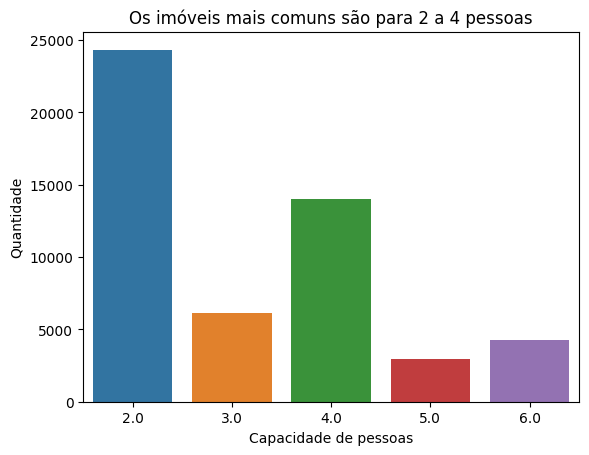

In [12]:
# Como se comporta a distribuição da capacidade de pessoas das locações?
# Verifica-se que imóveis para 2 a 4 pessoas são mais comuns
df4 = df.groupby('person_capacity').weekdays.count().reset_index()
df4 = df4.rename(columns={'weekdays': 'count'})

sns.barplot(df4, x = 'person_capacity', y='count').set(title = 'Os imóveis mais comuns são para 2 a 4 pessoas',
xlabel='Capacidade de pessoas', ylabel='Quantidade');

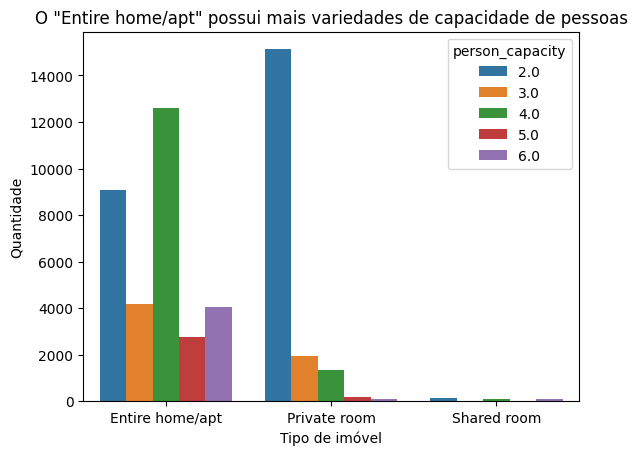

In [13]:
# Como funciona a distribuição da capacidade de pessoas por diferentes tipos de imóveis?
# Verifica-se, como esperado, que imóveis completos podem possuir maior capacidade,
# enquanto quartos privativos geralmente possuem capacidade para até 4 pessoas.

df5 = df.groupby(['room_type','person_capacity']).weekdays.count().reset_index()
df5 = df5.rename(columns={'weekdays': 'count'})

sns.barplot(df5, x = 'room_type', y='count', hue="person_capacity").set(title = 'O "Entire home/apt" possui mais variedades de capacidade de pessoas',
                                                                           xlabel='Tipo de imóvel', ylabel='Quantidade');

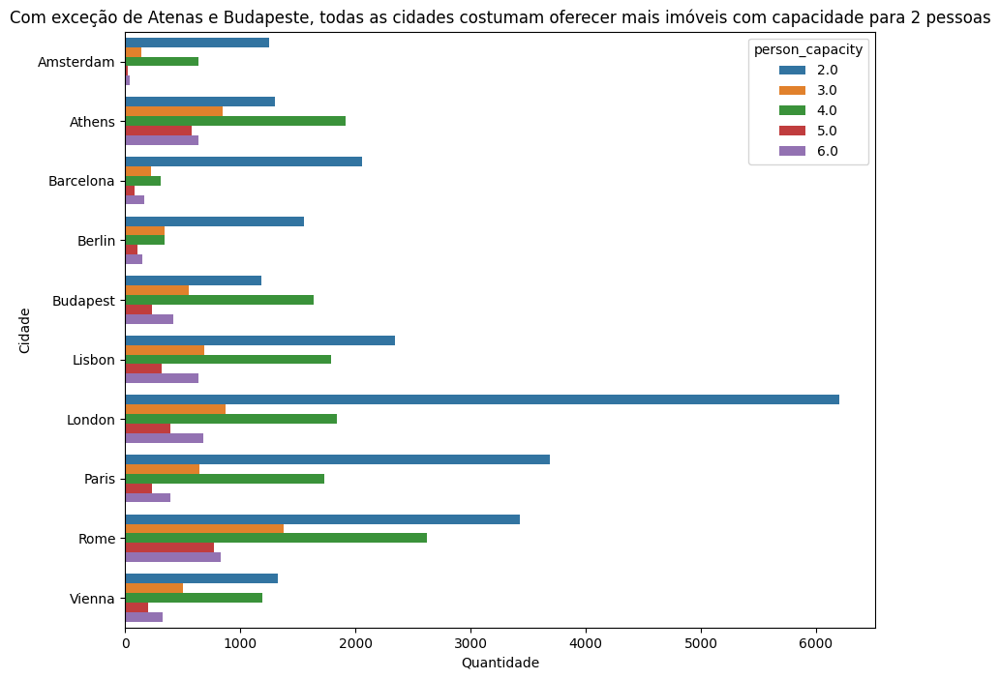

In [14]:
# E como estão distribuídas a capacidade de pessoas por cidade?
# Verifica-se que com exceção de Atenas e Budapeste a maioria das locações tem
# capacidade de 2 pessoas.
# Como esperado verifica-se relação da capacidade com o tipo de imóvel. Em Barcelona,
# Londres e Berlim, onde haviam mais imóveis do tipo quarto privado, a maioria da capacidade
# está em 2 pessoas.
df6 = df.groupby(['city','person_capacity']).weekdays.count().reset_index()
df6 = df6.rename(columns={'weekdays': 'count'})

plt.figure(figsize=(10,8))
sns.barplot(df6, y = 'city', x='count', hue="person_capacity").set(title = 'Com exceção de Atenas e Budapeste, todas as cidades costumam oferecer mais imóveis com capacidade para 2 pessoas',
                                                                           xlabel='Quantidade', ylabel='Cidade');

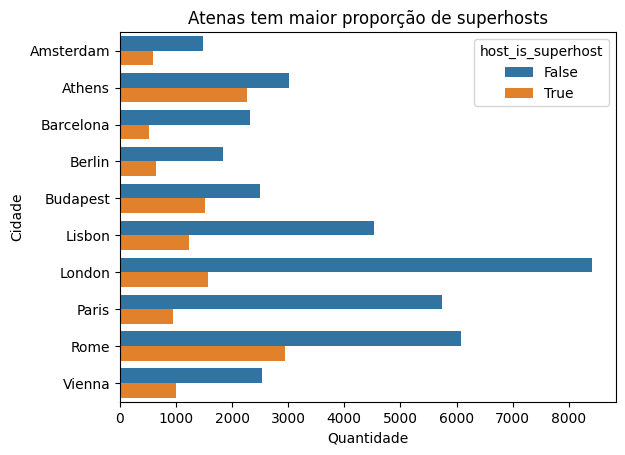

In [15]:
# Como ficam as proporções de superhosts por cidade?
# Verifica-se que a maior proporção de superhosts é em Atenas
df7 = df.groupby(['city', 'host_is_superhost']).weekdays.count().reset_index()
df7 = df7.rename(columns={'weekdays': 'count'})

sns.barplot(df7, y='city', x='count', hue="host_is_superhost").set(title='Atenas tem maior proporção de superhosts', xlabel='Quantidade', ylabel='Cidade');

<AxesSubplot: title={'center': 'Quanto maior a nota de limpeza, maior a satisfação'}, xlabel='cleanliness_rating', ylabel='guest_satisfaction_overall'>

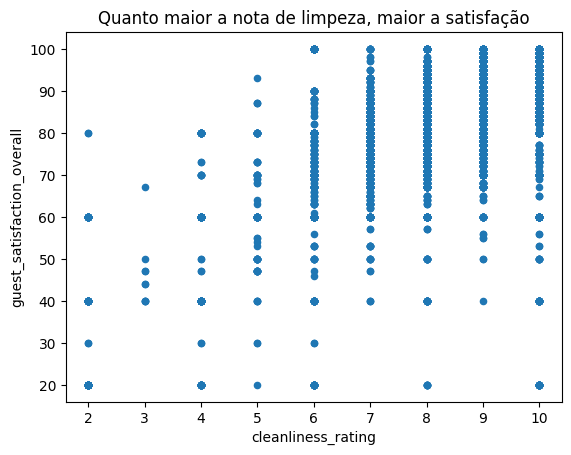

In [77]:
# Verificou-se que havia alta correlação entre a nota de limpeza
# e a nota geral
df.plot(x="cleanliness_rating", y="guest_satisfaction_overall", kind="scatter", title="Quanto maior a nota de limpeza, maior a satisfação")

[Text(0.5, 1.0, 'Clientes em geral estão satisfeitos')]

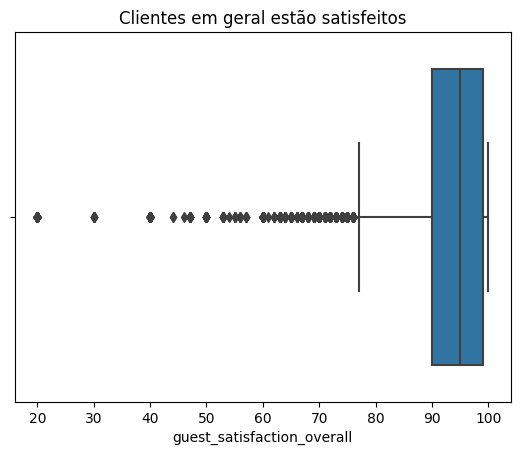

In [80]:
sns.boxplot(df, x="guest_satisfaction_overall").set(title="Clientes em geral estão satisfeitos")

[Text(0.5, 1.0, 'Nota 10 em limpeza para a maioria das locações')]

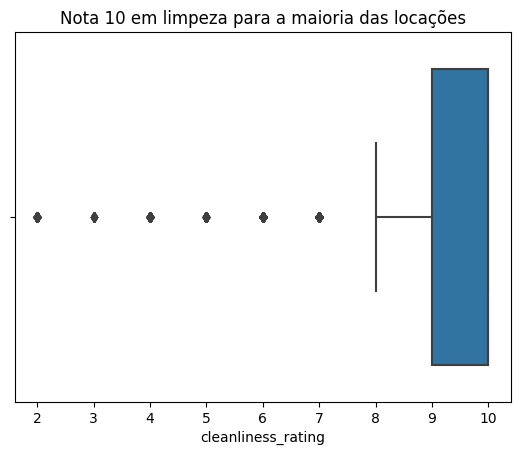

In [83]:
# Como estão as notas de limpeza?
sns.boxplot(df, x="cleanliness_rating").set(title="Nota 10 em limpeza para a maioria das locações")

Text(0.5, 1.0, 'Superhost são melhores avaliados')

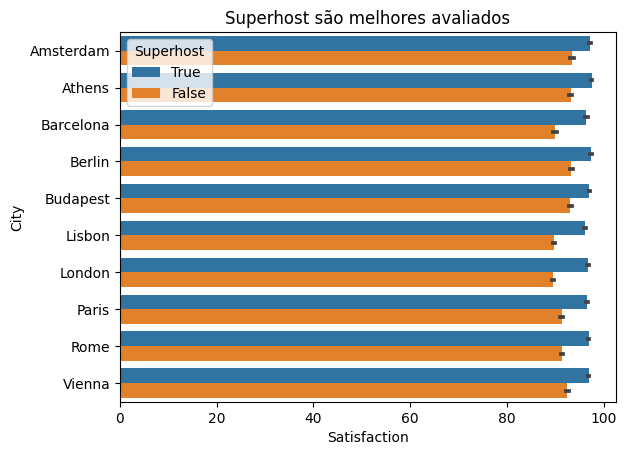

In [85]:
# Como se relacionam o preço, o status de superhost e a satisfação dos hóspedes?
# Grafico barra horizontal separado por cidade
sns.barplot(df, y="city", x="guest_satisfaction_overall", hue="host_is_superhost", hue_order=[True, False])
plt.legend(title='Superhost')
plt.xlabel('Satisfaction')
plt.ylabel('City')
plt.title('Superhost são melhores avaliados')
#Resposta - Sim, Superhosts são mais bem avaliados

In [103]:
# Há diferença de avaliação para diferentes tipos de locatários?
# biz = false & multi = false: quem só tem um anúncio
# biz = false & multi = true: quem tem de 2 a 4 anúncios
# biz = true & multi = false = quem tem >4 anúncios
def checa_tipo(row):
    if row['biz'] == False and row['multi'] == False:
        valor='1'
    elif row['biz'] == False and row['multi'] == True:
        valor='2-4'
    elif row['biz'] == True and row['multi'] == False:
        valor='>4'
    return pd.Series(valor)
df['cat'] = df.apply(checa_tipo, axis=1)

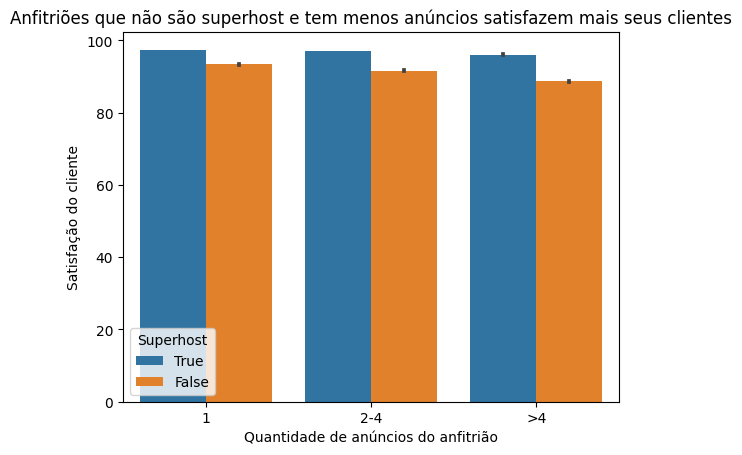

In [105]:
sns.barplot(df, x="cat", y="guest_satisfaction_overall", hue='host_is_superhost', hue_order=[True, False], order=['1', '2-4', '>4'])
plt.xlabel('Quantidade de anúncios do anfitrião')
plt.ylabel('Satisfação do cliente')
plt.title('Anfitriões que não são superhost e tem menos anúncios satisfazem mais seus clientes')
plt.legend(title='Superhost')

## Análise de preços

[Text(0.5, 1.0, 'Amsterdam aparenta ter a média de preços maior')]

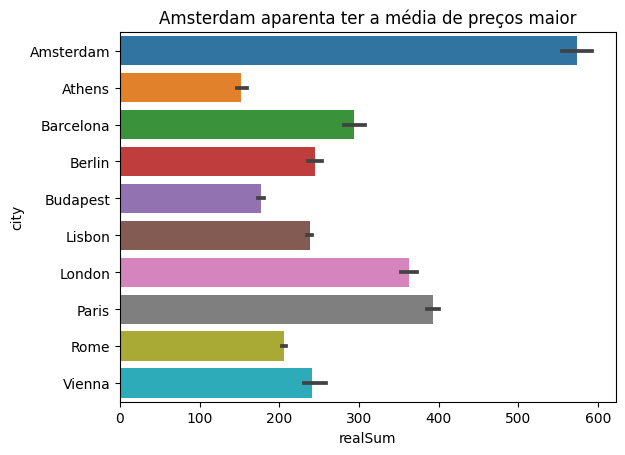

In [16]:
# Como é a média de valores de locação nas cidades analisadas?
sns.barplot(df, x="realSum", y="city").set(title='Amsterdam aparenta ter a média de preços maior')

[Text(0.5, 1.0, 'Muitos outliers!')]

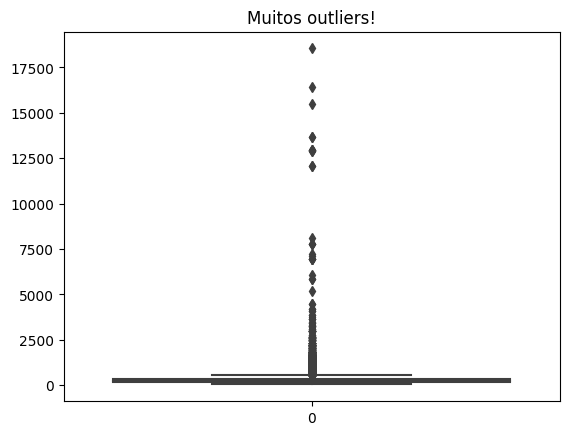

In [17]:
# Como é o boxplot dos valores de locação?
# Verifica-se que há muitos outliers com valores excessivamente alto
sns.boxplot(df["realSum"]).set(title='Muitos outliers!')

[Text(0.5, 1.0, 'Muitos outliers inclusive por cidade')]

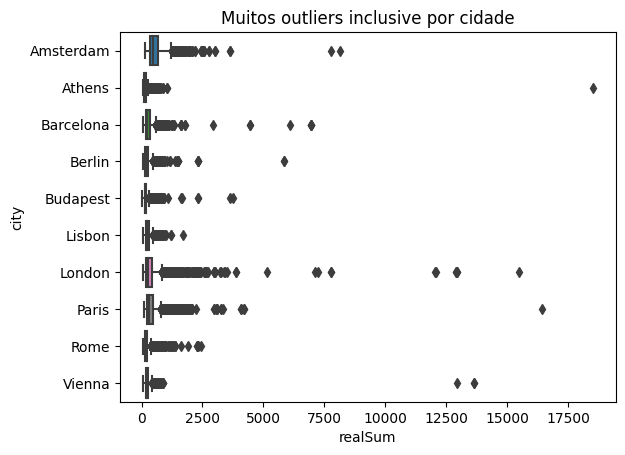

In [18]:
sns.boxplot(df, x="realSum", y="city").set(title='Muitos outliers inclusive por cidade')

[Text(0.5, 1.0, 'Atenas tem menor mediana de preços')]

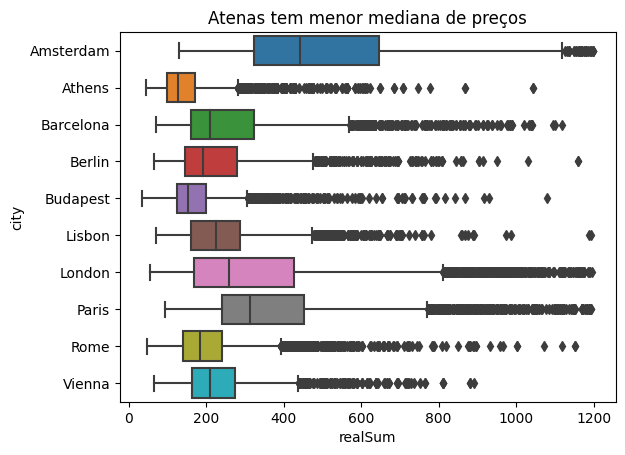

In [19]:
# Foram tantos outliers que para visualizar o boxplot de forma mais limpa,
# foi necessário filtrar o valor de locação para valores abaixo de EUR 1.200
# por 2 noites por casal
# Verifica-se que Atenas tem a mediana mais baixa.
sns.boxplot(df[df["realSum"]<1200], x="realSum", y="city").set(title='Atenas tem menor mediana de preços')

<AxesSubplot: xlabel='realSum', ylabel='city'>

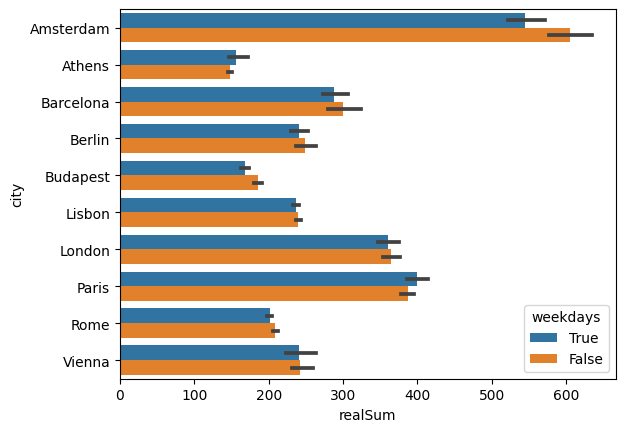

In [84]:
# Há diferença entre valor para semana ou final de semana?
# Verifica-se que Atenas e Paris possuem maior valor médio de
# locação para dias de semana que para finais de semana.
sns.barplot(df, x="realSum", y="city", hue="weekdays", hue_order=[True, False])

In [21]:
# Criando cópia do Dataframe e limitando o valor de locação em 1.500
copia_df = df.copy()
copia_df = copia_df[copia_df["realSum"]<1500]
# O valor apontado no DF é por 2 noites para 2 pessoas, vamos então
# calcular o valor por pessoa por noite:
copia_df["price_per_person"] = copia_df["realSum"] / 4
copia_df.describe(include="all", percentiles=[0,0.25,0.5,0.75,0.95,1]).T

,count,unique,top,freq,mean,std,min,0%,25%,50%,75%,95%,100%,max
city,51449,10,London,9881,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
weekdays,51449,2,False,26073,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
realSum,51449.0,NaN,NaN,NaN,266.487281,185.161271,34.779339,34.779339,148.639432,210.365854,317.062311,639.838511,1497.683389,1497.683389
room_type,51449,3,Entire home/apt,32427,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
room_shared,51449,2,False,51083,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
room_private,51449,2,False,32793,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
person_capacity,51449.0,NaN,NaN,NaN,3.155086,1.294595,2.0,2.0,2.0,3.0,4.0,6.0,6.0,6.0
host_is_superhost,51449,2,False,38262,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
multi,51449.0,NaN,NaN,NaN,0.291512,0.454463,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0
biz,51449.0,NaN,NaN,NaN,0.350444,0.477114,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0


[Text(0.5, 1.0, 'Sim, maior capacidade = maior preço')]

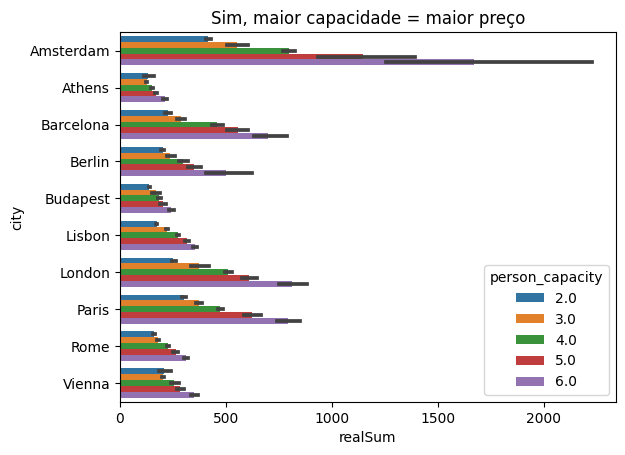

In [22]:
# Uma casa para mais pessoas (maior person_capacity) é necessariamente mais cara?
sns.barplot(df, x="realSum", y="city", hue="person_capacity").set(title='Sim, maior capacidade = maior preço')

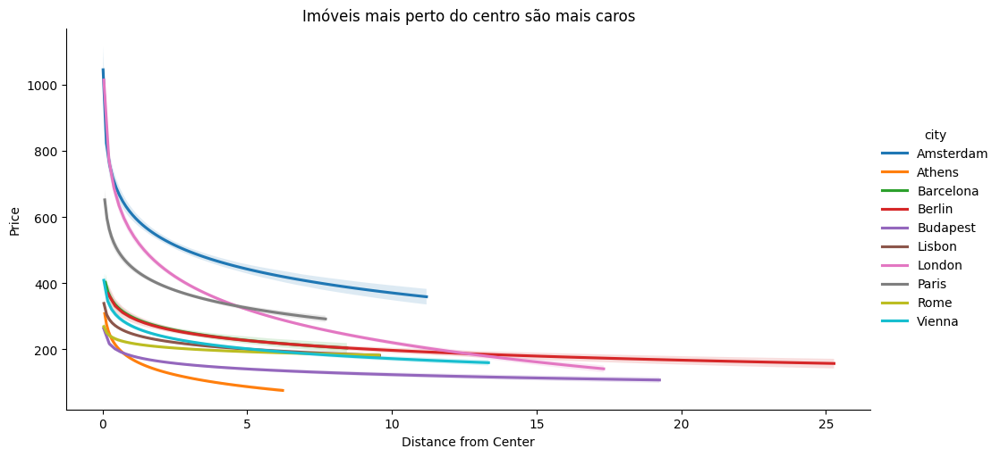

In [68]:
# O preço varia com a distância ao centro da cidade?
sns.lmplot(data=copia_df, x="dist", y="realSum", logx=True, hue="city", height=5, aspect=2, scatter=False).set(title='Imóveis mais perto do centro são mais caros', xlabel='Distance from Center', ylabel='Price')

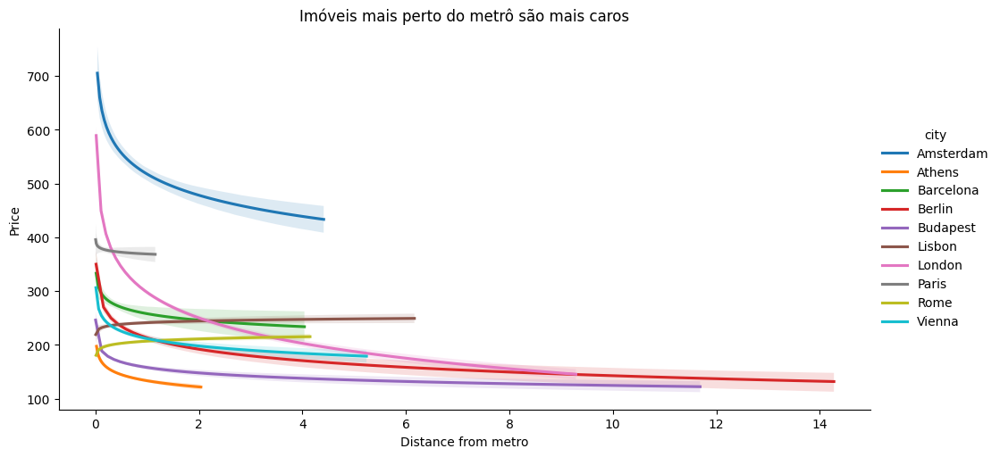

In [69]:
# O preço varia com a distância a estação de metrô?
sns.lmplot(data=copia_df, x="metro_dist", y="realSum", logx=True, hue="city", height=5, aspect=2, scatter=False).set(title='Imóveis mais perto do metrô são mais caros', xlabel='Distance from metro', ylabel='Price')

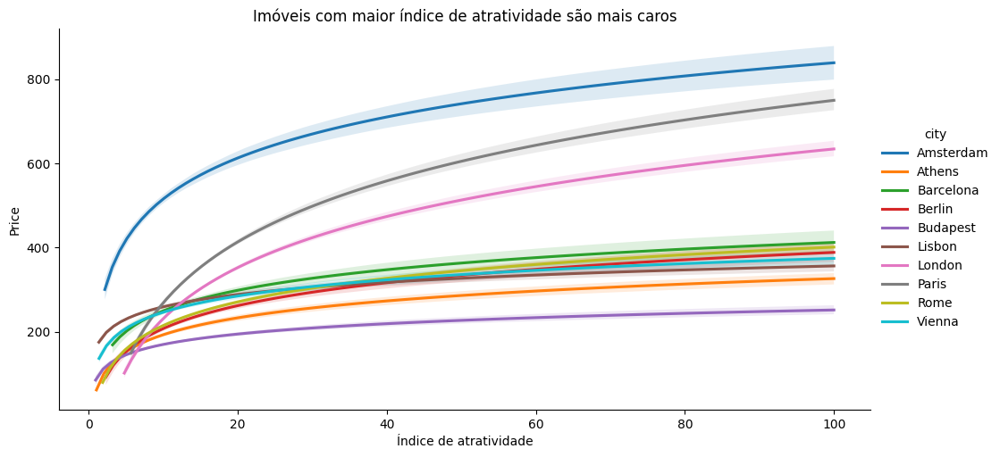

In [70]:
# O preço varia com o índice de atratividade?
sns.lmplot(data=copia_df, x="attr_index_norm", y="realSum", logx=True, hue="city", height=5, aspect=2, scatter=False).set(title='Imóveis com maior índice de atratividade são mais caros', xlabel='Índice de atratividade', ylabel='Price')

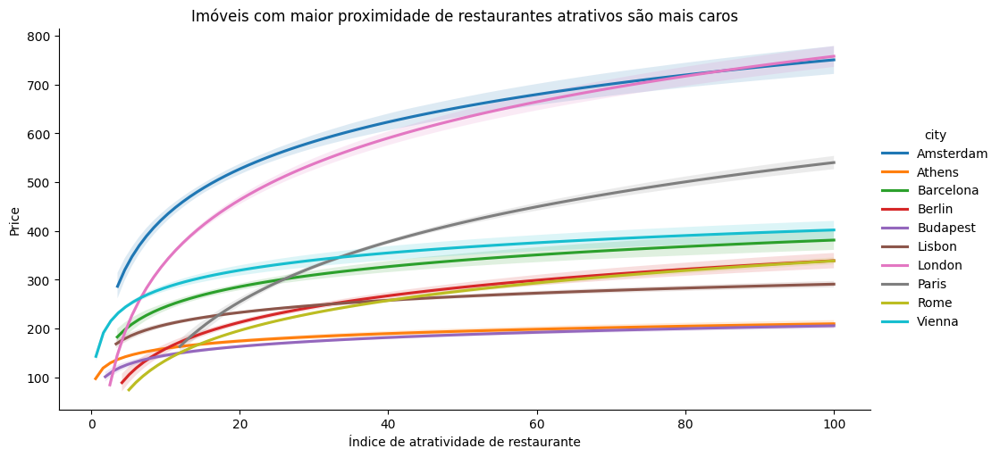

In [71]:
# O preço varia com a proximidade de restaurantes atrativos?
sns.lmplot(data=copia_df, x="rest_index_norm", y="realSum", logx=True, hue="city", height=5, aspect=2, scatter=False).set(title='Imóveis com maior proximidade de restaurantes atrativos são mais caros', xlabel='Índice de atratividade de restaurante', ylabel='Price')

## Visualização em mapas

In [106]:
# Visualizando os preços em locais através de mapas
geo_df = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.lng, df.lat))
geo_copia_df = gpd.GeoDataFrame(copia_df, geometry=gpd.points_from_xy(copia_df.lng, copia_df.lat))

#scatter plot com geo_df2
#use strong colors for the points
#change collor from light to dark as the price increases
#cor = preto
fig = px.scatter_mapbox(geo_copia_df, lat="lat", lon="lng", size="realSum", hover_name="city", zoom=3, height=500, color="realSum", color_continuous_scale=px.colors.sequential.Blackbody)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(mapbox_style="open-street-map")
fig.show()


In [107]:
fig = px.scatter_mapbox(geo_copia_df, lat="lat", lon="lng", hover_name="city", hover_data=["weekdays"], size="price_per_person",color = 'price_per_person', zoom=4, height=500, color_continuous_scale=px.colors.sequential.Viridis_r, range_color=[20,150])
fig.update_layout(
    mapbox_style="white-bg",
    mapbox_layers=[
        {
            "below": 'traces',
            "sourcetype": "raster",
            "source": [
                "https://a.basemaps.cartocdn.com/light_all/{z}/{x}/{y}.png"
            ]
        }
      ])
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()